# Understanding SAE Features with the Logit Lens

This notebook demonstrates how to use the mats_sae_training library to perform the analysis documented the post "[Understanding SAE Features with the Logit Lens](https://www.alignmentforum.org/posts/qykrYY6rXXM7EEs8Q/understanding-sae-features-with-the-logit-lens)". 

As such, the notebook will include sections for:
- Loading in GPT2-Small Residual Stream SAEs from Huggingface. 
- Performing Virtual Weight Based Analysis of features (specifically looking at the logit weight distributions).
- Programmatically opening neuronpedia tabs to engage with public dashboards on [neuronpedia](https://www.neuronpedia.org/).
- Performing Token Set Enrichment Analysis (based on Gene Set Enrichment Analysis). 

## Set Up

Here we'll load various functions for things like:
- downloading and loading our SAEs from huggingface. 
- opening neuronpedia from a jupyter cell. 
- calculating statistics of the logit weight distributions. 
- performing Token Set Enrichment Analysis (TSEA) and plotting the results.

### Imports

In [11]:
import sys

#sys.path.append("..")

import numpy as np
import torch
import plotly_express as px
import matplotlib.pyplot as plt

from transformer_lens import HookedTransformer

# Model Loading
from sae_lens.analysis.toolkit import get_all_gpt2_small_saes, open_neuronpedia

# Virtual Weight / Feature Statistics Functions
from sae_lens.analysis.feature_statistics import get_all_stats_dfs, get_W_U_W_dec_stats_df

# Enrichment Analysis Functions
from sae_lens.analysis.tsea import (
    get_enrichment_df,
    manhattan_plot_enrichment_scores,
    plot_top_k_feature_projections_by_token_and_category,
)
from sae_lens.analysis.tsea import (
    get_constantins_gene_sets,
    process_gene_sets,
    get_baby_name_sets,
    get_letter_gene_sets,
    generate_pos_sets,
    get_test_gene_sets,
    get_gene_set_from_regex,
)

### Loading GPT2 Small and SAE Weights

This will take a while the first time you run it, but will be quick thereafter.

In [12]:
model = HookedTransformer.from_pretrained("gpt2-small")
gpt2_small_sparse_autoencoders, gpt2_small_sae_sparsities = get_all_gpt2_small_saes()
W_dec_all_layers = torch.stack(
    [
        gpt2_small_sparse_autoencoders[i].W_dec.detach().cpu()
        for i in gpt2_small_sparse_autoencoders.keys()
    ],
    dim=0,
)

Loaded pretrained model gpt2-small into HookedTransformer


# Statistical Properties of Feature Logit Distributions

In the post I study layer 8 (for no particular reason). At the end of this notebook is code for visualizing these statistics across all layers. Feel free to change the layer here and explore different layers. 

In [13]:
# In the post, I focus on layer 8
layer = 8
#layer = 4


# get the corresponding SAE and feature sparsities.
sparse_autoencoder = gpt2_small_sparse_autoencoders[f"blocks.{layer}.hook_resid_pre"]
log_feature_sparsity = gpt2_small_sae_sparsities[f"blocks.{layer}.hook_resid_pre"].cpu()
W_dec = sparse_autoencoder.W_dec.detach().cpu()

# calculate the statistics of the logit weight distributions
W_U_stats_df_dec, dec_projection_onto_W_U = get_W_U_W_dec_stats_df(
    W_dec, model, cosine_sim=False
)
W_U_stats_df_dec["sparsity"] = (
    log_feature_sparsity  # add feature sparsity since it is often interesting.
)
display(W_U_stats_df_dec)

,feature,mean,std,skewness,kurtosis,sparsity
0,0,1.518076e-10,0.147306,0.181176,3.349324,-2.826817
1,1,-1.157533e-08,0.167641,0.123870,3.466491,-3.049473
2,2,-2.890037e-08,0.157237,0.097977,3.300671,-2.960210
3,3,-1.518076e-10,0.174304,0.133900,3.522123,-2.822145
4,4,1.132864e-08,0.190366,0.212915,3.326519,-2.125533
...,...,...,...,...,...,...
24571,24571,1.408015e-08,0.205128,0.320509,3.330734,-1.933250
24572,24572,3.596891e-08,0.163037,0.112237,3.468480,-3.279720
24573,24573,2.743922e-08,0.166876,0.311090,4.092549,-2.592994
24574,24574,1.643317e-08,0.170027,0.359409,3.876930,-3.186663


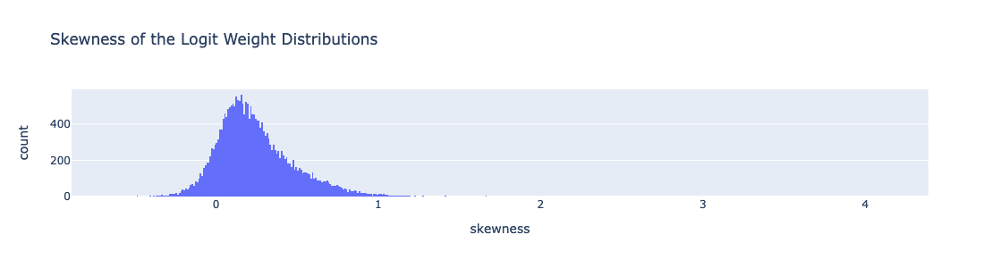

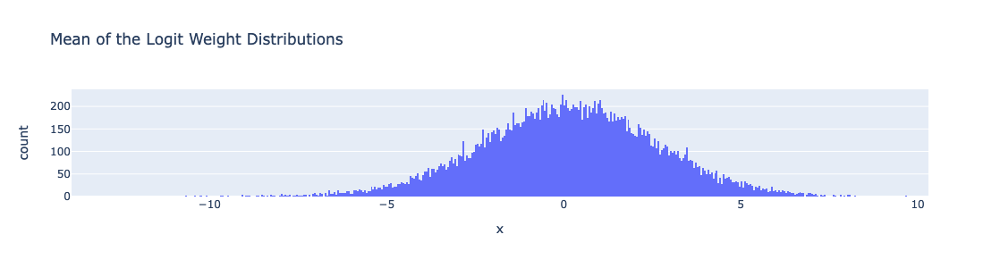

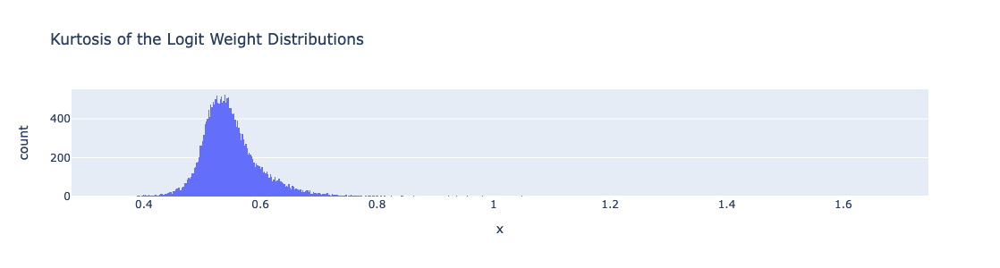

In [14]:
# Let's look at the distribution of the 3rd / 4th moments. I found these aren't as useful on their own as joint distributions can be.
px.histogram(
    W_U_stats_df_dec,
    x="skewness",
    width=800,
    height=300,
    nbins=1000,
    title="Skewness of the Logit Weight Distributions",
).show()

px.histogram(
    W_U_stats_df_dec,
    x=W_U_stats_df_dec["mean"]*1e8,
    width=800,
    height=300,
    nbins=1000,
    title="Mean of the Logit Weight Distributions",
).show()

px.histogram(
    W_U_stats_df_dec,
    x=np.log10(W_U_stats_df_dec["kurtosis"]),
    width=800,
    height=300,
    nbins=1000,
    title="Kurtosis of the Logit Weight Distributions",
).show()

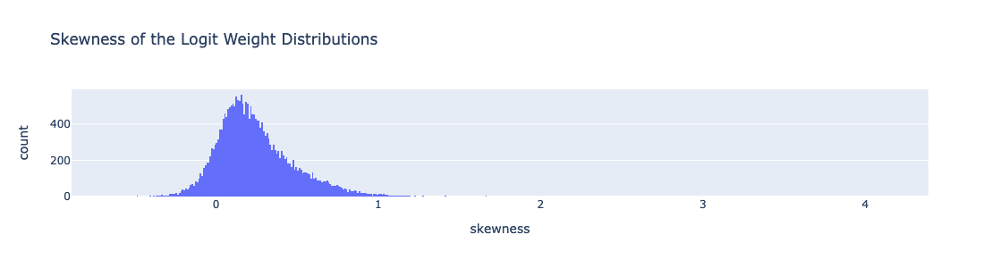

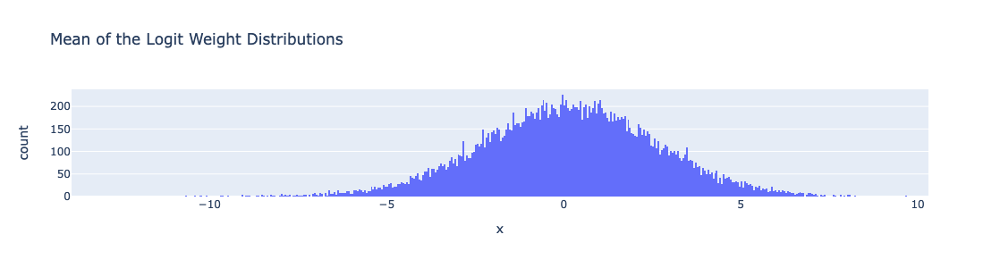

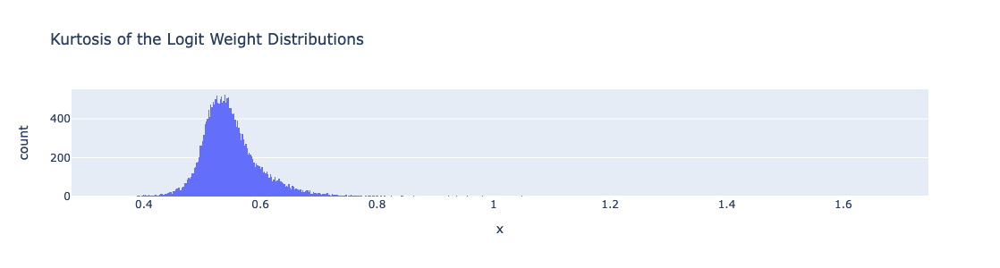

In [15]:
# Let's look at the distribution of the 3rd / 4th moments. I found these aren't as useful on their own as joint distributions can be.
px.histogram(
    W_U_stats_df_dec,
    x="skewness",
    width=800,
    height=300,
    nbins=1000,
    title="Skewness of the Logit Weight Distributions",
).show()

px.histogram(
    W_U_stats_df_dec,
    x=W_U_stats_df_dec["mean"]*1e8,
    width=800,
    height=300,
    nbins=1000,
    title="Mean of the Logit Weight Distributions",
).show()

px.histogram(
    W_U_stats_df_dec,
    x=np.log10(W_U_stats_df_dec["kurtosis"]),
    width=800,
    height=300,
    nbins=1000,
    title="Kurtosis of the Logit Weight Distributions",
).show()

In [16]:
W_U_stats_df_dec["mean_e8"] = W_U_stats_df_dec["mean"]*1e8

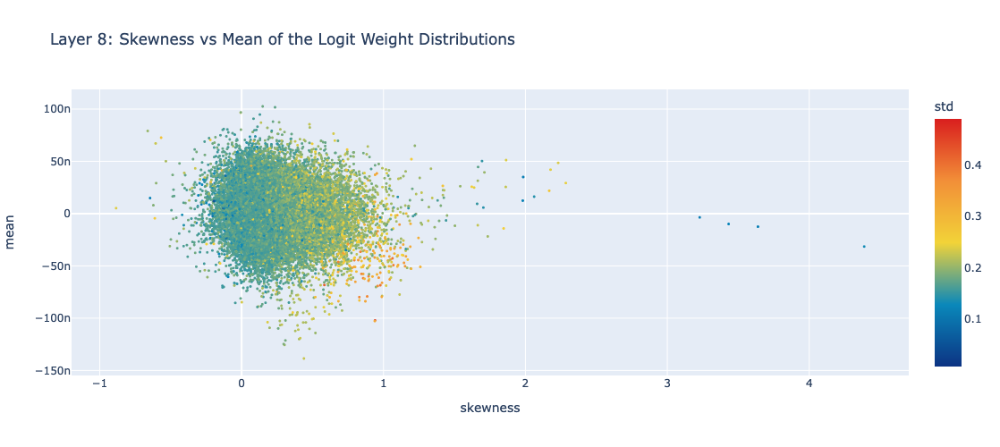

In [17]:
fig = px.scatter(
    W_U_stats_df_dec,
    x="skewness",
    y="mean",
    color="std",
    color_continuous_scale="Portland",
    hover_name="feature",
    width=800,
    height=500,
    #log_y=True,  # Kurtosis has larger outliers so logging creates a nicer scale.
    labels={"x": "Skewness", "y": "Kurtosis", "color": "Standard Deviation"},
    title=f"Layer {8}: Skewness vs Mean of the Logit Weight Distributions",
)

# decrease point size
fig.update_traces(marker=dict(size=3))


fig.show()

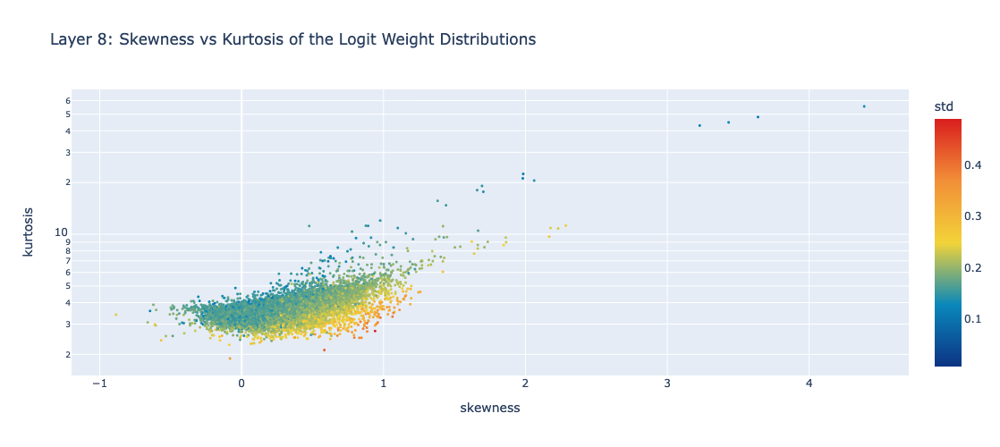

In [18]:
fig = px.scatter(
    W_U_stats_df_dec,
    x="skewness",
    y="kurtosis",
    color="std",
    color_continuous_scale="Portland",
    hover_name="feature",
    width=800,
    height=500,
    log_y=True,  # Kurtosis has larger outliers so logging creates a nicer scale.
    labels={"x": "Skewness", "y": "Kurtosis", "color": "Standard Deviation"},
    title=f"Layer {8}: Skewness vs Kurtosis of the Logit Weight Distributions",
)

# decrease point size
fig.update_traces(marker=dict(size=3))


fig.show()

0 0
0 1
0 2
1 0
1 1
1 2
2 0
2 1
2 2
similarities :  [[ 0.52894095  0.02021026 -0.01216166]
 [ 0.02021026  0.00713778  0.00794121]
 [-0.01216166  0.00794121  0.02659748]]


/var/folders/nm/_5h0j_fs6831bf2l49l4l9xh0000gn/T/ipykernel_12947/1746908723.py:47: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/var/folders/nm/_5h0j_fs6831bf2l49l4l9xh0000gn/T/ipykernel_12947/1746908723.py:50: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



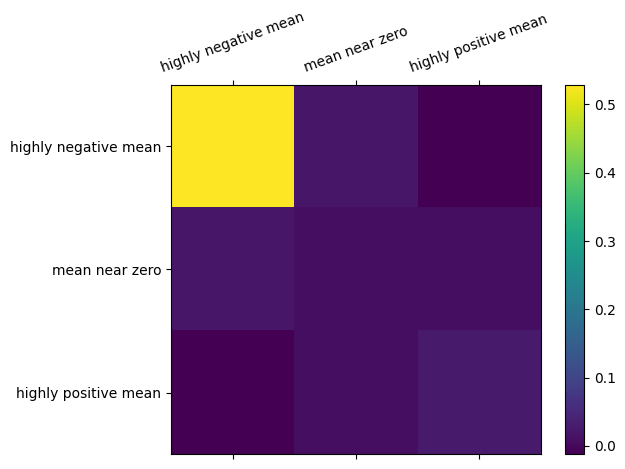

In [19]:
# Understanding if the "a" features are closer 





group_names= ["highly negative mean", "mean near zero", "highly positive mean"]

indices_for_groups = np.array([
    [19954, 5625, 2986, 18343],
    [21107, 18555, 13831, 13478], # found with W_U_stats_df_dec[( abs(W_U_stats_df_dec["mean"]) < 1.2e-12)]
    [17858, 20555, 20375, 1928],
])


n_groups = indices_for_groups.shape[0]
n_exemplars = indices_for_groups.shape[1]


import itertools
def cosinesim_from_two_indices(i, j):
    return torch.nn.CosineSimilarity(dim=0)(W_dec[i], W_dec[j]).item()

def mean_cosinesim_within_group(indices_group_A):
    return np.mean([cosinesim_from_two_indices(i,j) for i, j in itertools.combinations(indices_group_A, 2)])

def mean_cosinesim_between_groups(indices_group_A, indices_group_B):
    return np.mean([cosinesim_from_two_indices(i,j) for i, j in itertools.product(indices_group_A,indices_group_B)])

similarities = np.zeros((n_groups,n_groups))

for i,j in itertools.product(range(n_groups),range(n_groups)):
    print(i,j)
    if i==j:
        similarities[i,i] = mean_cosinesim_within_group(indices_for_groups[i])
    else:
        similarities[i,j] = mean_cosinesim_between_groups(indices_for_groups[i], indices_for_groups[j])
        
print("similarities : ", similarities)

fig = plt.figure()
#plt.title("Cosine similaries between different SAE features of different means")
ax = fig.add_subplot(111)
cax = ax.matshow(similarities, interpolation='nearest')
fig.colorbar(cax)

ax.set_xticklabels(['']+group_names)
plt.xticks(rotation=20)
#ax.xaxis.tick_top()
ax.set_yticklabels(['']+group_names)

plt.show()

In [20]:
# then you can query accross combinations of the statistics to find features of interest and open them in neuronpedia.
#tmp_df = W_U_stats_df_dec[["feature", "skewness", "kurtosis", "std"]]
tmp_df = W_U_stats_df_dec
# tmp_df = tmp_df[(tmp_df["std"] > 0.04)]
# tmp_df = tmp_df[(tmp_df["skewness"] > 0.65)]
#tmp_df = tmp_df[(tmp_df["skewness"] > 3)]
#tmp_df = tmp_df[(tmp_df["skewness"] < -0.64)]
#tmp_df = tmp_df[(tmp_df["mean"] < -1.2e-7)]
tmp_df = tmp_df[(tmp_df["mean"] > 9e-8)]

tmp_df = tmp_df.sort_values("skewness", ascending=False).head(10)
display(tmp_df)

# if desired, open the features in neuronpedia
for feature in tmp_df.feature:
    open_neuronpedia(feature, layer=layer)

,feature,mean,std,skewness,kurtosis,sparsity,mean_e8
20555,20555,1.016921e-07,0.173446,0.235501,3.337715,-2.221584,10.169211
17858,17858,1.025460e-07,0.179859,0.148275,3.037698,-2.926439,10.254603
15490,15490,9.472794e-08,0.156732,0.128482,3.618988,-3.379618,9.472795
5199,5199,9.077620e-08,0.161332,0.083700,3.165104,-3.563529,9.077620
20375,20375,9.685325e-08,0.190163,-0.005348,3.149605,-2.597084,9.685325
1928,1928,9.662553e-08,0.220566,-0.006617,2.738151,-3.116677,9.662554


Feature 20555


python(15957) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
python(15958) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


Feature 17858


python(15962) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


Feature 15490


python(15964) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


Feature 5199


python(15966) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


Feature 20375


python(15968) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


Feature 1928


python(15970) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [21]:
# then you can query accross combinations of the statistics to find features of interest and open them in neuronpedia.
tmp_df = W_U_stats_df_dec[["feature", "skewness", "kurtosis", "std"]]
# tmp_df = tmp_df[(tmp_df["std"] > 0.04)]
# tmp_df = tmp_df[(tmp_df["skewness"] > 0.65)]
tmp_df = tmp_df[(tmp_df["skewness"] > 3)]
tmp_df = tmp_df.sort_values("skewness", ascending=False).head(10)
display(tmp_df)

# if desired, open the features in neuronpedia
for feature in tmp_df.feature:
    open_neuronpedia(feature, layer=layer)

,feature,skewness,kurtosis,std
14215,14215,4.387646,55.515957,0.133079
19273,19273,3.638765,48.143673,0.115937
8992,8992,3.432152,44.810345,0.123028
895,895,3.228184,42.953152,0.112418


Feature 14215


python(15972) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


Feature 19273


python(15974) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


Feature 8992


python(15976) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


Feature 895


python(15978) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


# Token Set Enrichment Analysis

We now proceed to token set enrichment analysis.  I highly recommend reading my AlignmentForum post (espeically the case studies) before reading too much into any of these results. 
Also read this [post](https://transformer-circuits.pub/2024/qualitative-essay/index.html) for good general perspectives on statistics here. 

## Defining Our Token Sets

In [22]:
import nltk
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /Users/weisser/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [23]:
def process_gene_sets_first(model: HookedTransformer, gene_sets: dict[str, list[str]]) -> dict[str, set[int]]:

    def convert_tokens_to_ids(
            list_of_strings: list[str], model: HookedTransformer
    ) -> set[int]:
        token_ids = [
            model.tokenizer.encode(f" {word}", add_special_tokens=False)  # type: ignore
            for word in list_of_strings
        ]
        #token_ids = [item for sublist in token_ids for item in sublist]
        token_ids = [sublist[0] for sublist in token_ids]
        return set(token_ids)

    gene_sets_token_ids = {
        key: convert_tokens_to_ids(value, model) for key, value in gene_sets.items()
    }  # type: ignore

    return gene_sets_token_ids

In [24]:
# get the vocab we need to filter to formulate token sets.
vocab = model.tokenizer.get_vocab()  # type: ignore

# make a regex dictionary to specify more sets.
regex_dict = {
    "starts_with_space": r"Ġ.*",
    "starts_with_capital": r"^Ġ*[A-Z].*",
    "starts_with_lower": r"^Ġ*[a-z].*",
    "all_digits": r"^Ġ*\d+$",
    "is_punctuation": r"^[^\w\s]+$",
    "contains_close_bracket": r".*\).*",
    "contains_open_bracket": r".*\(.*",
    "all_caps": r"Ġ*[A-Z]+$",
    "1 digit": r"Ġ*\d{1}$",
    "2 digits": r"Ġ*\d{2}$",
    "3 digits": r"Ġ*\d{3}$",
    "4 digits": r"Ġ*\d{4}$",
    "length_1": r"^Ġ*\w{1}$",
    "length_2": r"^Ġ*\w{2}$",
    "length_3": r"^Ġ*\w{3}$",
    "length_4": r"^Ġ*\w{4}$",
    "length_5": r"^Ġ*\w{5}$",
}

# print size of gene sets
all_token_sets = {}
print("1 ", len(all_token_sets))

# GPT2 release was in 2019
#

# recognizeable first names of male soccer players (not goalies)
l_first_field_male = ["Lionel", "Virgil","Sadio"]

l_last_field_male = ["Messi","Ronaldo", "Mané", "Salah", "Mbappé", "Lewandowski", "Sterling", "Agüero", "Hazard", "Kroos", "Modric", "Jong", "Firmino", "Bruyne", "Kane"]

l_last_goal_male = ["Alisson", "ter Stegen", "Neuer", "Oblak", "Lloris", "EDERSON", "COURTOIS", "NAVAS", "ARMANI"]

l_last_field_female = ["Kerr", "Bronze", "Rapinoe", "Hegerberg", "Henry", "Miedema", "Lavelle", "Harder"]

l_american_football = ["Donald", "Brees", "Mack", "Mahomes", "Gurley", "Brady", "Kamara", "Barkley", "Rivers"]





gene_sets = {
    "l_first_field_male": l_first_field_male,
    "l_last_field_male": l_last_field_male,
    "l_last_goal_male": l_last_goal_male, 
    "l_last_field_female": l_last_field_female,
    "l_american_football": l_american_football,
}


for key in gene_sets:
    gene_sets[key] = [string.lower() for string in gene_sets[key]]


# some other sets that can be interesting
#baby_name_sets = get_baby_name_sets(vocab)
#pos_sets = generate_pos_sets(vocab)
#arbitrary_sets = get_test_gene_sets(model)
#letter_sets = get_letter_gene_sets(vocab)
constantin_sets = get_constantins_gene_sets(model)
#custom_sets = process_gene_sets(model, gene_sets)
custom_sets = process_gene_sets_first(model, gene_sets)

"""
regex_sets = {}
for key, value in regex_dict.items():
    gene_set = get_gene_set_from_regex(vocab, value)
    regex_sets[key] = gene_set
"""

#all_token_sets = letter_sets
#all_token_sets = {**all_token_sets, **pos_sets}
#all_token_sets = {**all_token_sets, **arbitrary_sets}
#all_token_sets = {**all_token_sets, **baby_name_sets}
all_token_sets = {**all_token_sets, **constantin_sets}
all_token_sets = {**all_token_sets, **custom_sets}



# for each gene set, convert to string and  print the first 5 tokens
for token_set_name, gene_set in sorted(
    all_token_sets.items(), key=lambda x: len(x[1]), reverse=True
):
    tokens = [model.to_string(id) for id in list(gene_set)]#[:10]  # type: ignore
    print(f"{token_set_name}, has {len(gene_set)} genes")
    print(tokens)
    print("----")

1  0
ml, has 15 genes
[' open', ' learning', ' gener', ' language', ' foundation', 'pt', ' ml', 'ative', 'ai', ' learn', ' g', ' transformer', ' model', ' machine', ' gen']
----
l_last_field_male, has 14 genes
[' bru', ' sterling', ' mess', ' man', ' fir', ' ag', ' sal', ' j', ' r', ' mod', ' hazard', ' le', ' m', ' k']
----
l_last_goal_male, has 9 genes
[' nav', ' ar', ' ter', ' cour', ' ed', ' ob', ' ne', ' al', ' ']
----
l_american_football, has 9 genes
[' br', ' don', ' rivers', ' bre', ' bark', ' mah', ' g', ' m', ' k']
----
l_last_field_female, has 8 genes
[' k', ' harder', ' la', ' hen', ' he', ' bronze', ' m', ' rap']
----
all_articles, has 3 genes
[' a', ' an', ' the']
----
l_first_field_male, has 3 genes
[' lion', ' sad', ' vir']
----
non_particular_articles, has 2 genes
[' a', ' an']
----
particular_articles, has 1 genes
[' the']
----


## Performing Token Set Enrichment Analysis

Below we perform token set enrichment analysis on various token sets. In practice, we'd likely perform tests accross all tokens and large libraries of sets simultaneously but to make it easier to run, we look at features with higher skew and select of a few token sets at a time to consider.

In [25]:
features_ordered_by_skew = (
    W_U_stats_df_dec["skewness"].sort_values(ascending=False).head(5000).index.to_list()
)

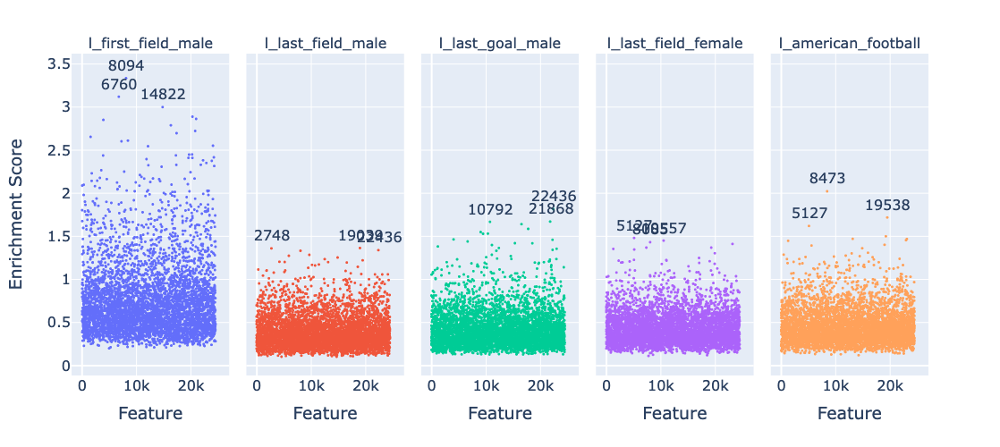

In [26]:
# filter our list.
"""
token_sets_index = [
    "starts_with_space",
    "starts_with_capital",
    "all_digits",
    "is_punctuation",
    "all_caps",
]
"""

token_sets_index = custom_sets.keys()
token_set_selected = {
    k: set(v) for k, v in all_token_sets.items() if k in token_sets_index
}

# calculate the enrichment scores
df_enrichment_scores = get_enrichment_df(
    dec_projection_onto_W_U,  # use the logit weight values as our rankings over tokens.
    features_ordered_by_skew,  # subset by these features
    token_set_selected,  # use token_sets
)

manhattan_plot_enrichment_scores(
    df_enrichment_scores, label_threshold=0, top_n=3  # use our enrichment scores
).show()

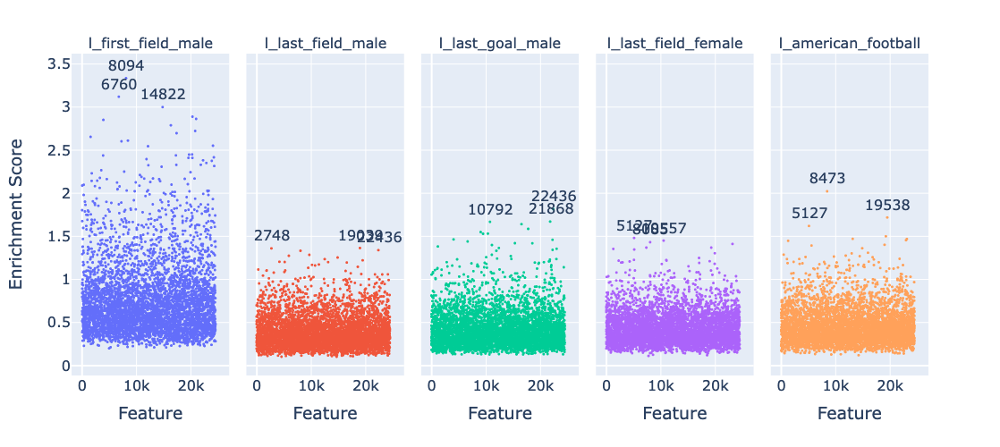

In [27]:
manhattan_plot_enrichment_scores(
    df_enrichment_scores, label_threshold=0, top_n=3  # use our enrichment scores
).show()

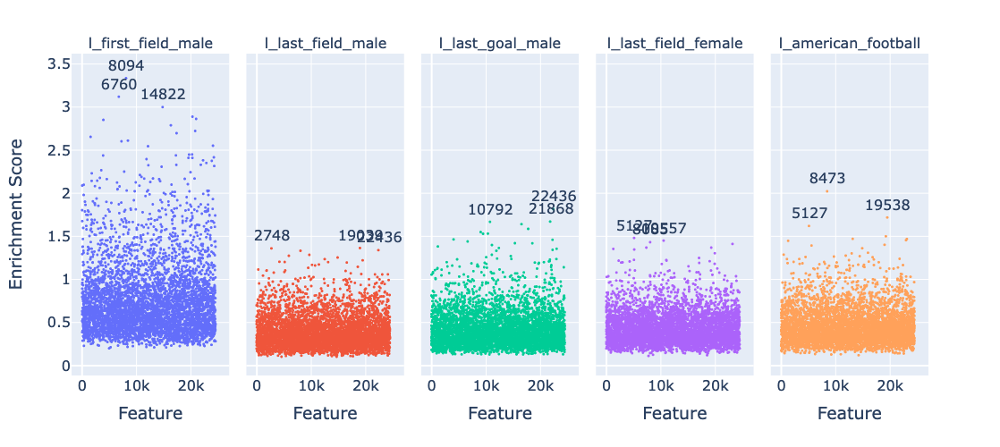

In [28]:
manhattan_plot_enrichment_scores(
    df_enrichment_scores, label_threshold=0, top_n=3  # use our enrichment scores
).show()